In [1]:
import tensorflow as tf
import numpy as np
import os
from PIL import Image

In [83]:
labels = ['Palm','Fist']
y_train = []
x_train = []
path = "Data/Images"
pos = "Data/Positions"
res = [300, 400]
for i in os.listdir(path):
    for j in os.listdir(path + "/" + i):
        im =  Image.open(path + "/" + i + '/' + j)
        im = im.resize((240,240), Image.LANCZOS)
        im = np.array(im)
        #im = im/255.0
        #im = np.expand_dims(im,axis = 2)
        x_train.append(im)
        f = open(pos + "/" + i + "/" + j.split(".")[0] + ".txt", "r")
        temp = f.read().split()
        for k in range(2):
            temp[k] = int(temp[k])/res[k]*240
        y_train.append(temp)
        f.close()

x = np.array(x_train)
y = np.array(y_train)

print(x.shape)
print(y.shape)

(202, 240, 240, 3)
(202, 2)


In [84]:
from sklearn.model_selection import train_test_split

x_train, x_val, y_train, y_val = train_test_split(x, y, train_size=0.80, random_state=42)

In [36]:
input = tf.keras.layers.Input(shape=(240, 240, 3))
x = tf.keras.layers.Conv2D(16, (3, 3), activation='relu')(input)
x = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(x)
x = tf.keras.layers.Conv2D(32, (3, 3), activation='relu')(x)
x = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(x)
x = tf.keras.layers.Conv2D(64, (3, 3), activation='relu')(x)
x = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(x)
x = tf.keras.layers.Conv2D(128, (3, 3), activation='relu')(x)
x = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(x)
x = tf.keras.layers.Flatten()(x)

x = tf.keras.layers.Dense(128, activation='relu')(x)
x = tf.keras.layers.Dense(32, activation='relu')(x)
x = tf.keras.layers.Dense(2)(x)


model = tf.keras.Model(input, x)

model.compile(optimizer='adam', loss='mse', metrics='mae')

model.fit(x_train, y_train, epochs=1000, batch_size=128, validation_data=(x_val, y_val))

Epoch 1/1000
2/2 [==============================] - 3s 531ms/step - loss: 23724.3008 - mae: 140.8606 - val_loss: 4757.6567 - val_mae: 56.7812
Epoch 2/1000
2/2 [==============================] - 1s 345ms/step - loss: 5781.5186 - mae: 63.4402 - val_loss: 7328.8643 - val_mae: 69.7540
Epoch 3/1000
2/2 [==============================] - 1s 344ms/step - loss: 6752.7437 - mae: 68.2316 - val_loss: 4155.5566 - val_mae: 54.5497
Epoch 4/1000
2/2 [==============================] - 1s 344ms/step - loss: 3344.2842 - mae: 49.2413 - val_loss: 2677.6680 - val_mae: 42.2914
Epoch 5/1000
2/2 [==============================] - 1s 348ms/step - loss: 2214.0623 - mae: 39.6887 - val_loss: 2793.3157 - val_mae: 44.2938
Epoch 6/1000
2/2 [==============================] - 1s 391ms/step - loss: 2952.5276 - mae: 46.5172 - val_loss: 2261.1313 - val_mae: 41.0530
Epoch 7/1000
2/2 [==============================] - 1s 348ms/step - loss: 2147.6272 - mae: 39.4841 - val_loss: 2550.7773 - val_mae: 42.0701
Epoch 8/1000
2/2 [

In [37]:
# Execute Cell Index 3 first to define and train the model

model.evaluate(x_val, y_val)


2/2 [==============================] - 0s 21ms/step - loss: 28.6625 - mae: 3.4366


[28.662458419799805, 3.4365975856781006]

1/1 [==============================] - 0s 32ms/step
[[128.74312   81.063995]]
[129.6 103.8]


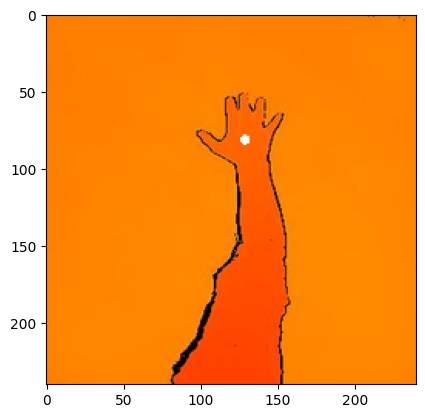

In [82]:
im = x_val[10]
predictions = model.predict(im.reshape(1, 240, 240, 3))

print(predictions)
print(y_val[10])

for x in range(240):
    for y in range(240):
        if((x - predictions[0][0])**2 + (y - predictions[0][1])**2 < 10):
            im[y][x] = [255, 255, 255]

import matplotlib.pyplot as plt
plt.imshow(im)
plt.show()




In [73]:
import tf2onnx

tf2onnx.convert.from_keras(model, output_path="hand_position.onnx")

(ir_version: 8
 producer_name: "tf2onnx"
 producer_version: "1.16.1 15c810"
 graph {
   node {
     input: "input_6"
     output: "model_5/conv2d_20/BiasAdd__6:0"
     name: "model_5/conv2d_20/BiasAdd__6"
     op_type: "Transpose"
     attribute {
       name: "perm"
       ints: 0
       ints: 3
       ints: 1
       ints: 2
       type: INTS
     }
   }
   node {
     input: "model_5/conv2d_20/BiasAdd__6:0"
     input: "model_5/conv2d_20/Conv2D/ReadVariableOp:0"
     input: "model_5/conv2d_20/BiasAdd/ReadVariableOp:0"
     output: "model_5/conv2d_20/BiasAdd:0"
     name: "model_5/conv2d_20/BiasAdd"
     op_type: "Conv"
     attribute {
       name: "dilations"
       ints: 1
       ints: 1
       type: INTS
     }
     attribute {
       name: "strides"
       ints: 1
       ints: 1
       type: INTS
     }
     attribute {
       name: "kernel_shape"
       ints: 3
       ints: 3
       type: INTS
     }
     attribute {
       name: "group"
       i: 1
       type: INT
     }
     

[array([[108.91923, 202.90913]], dtype=float32)]
[108.8 201. ]


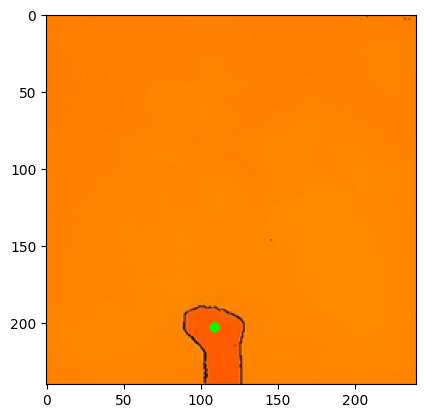

In [94]:
import onnxruntime
import matplotlib.pyplot as plt

img = x_val[19]


# Load the ONNX model
sess = onnxruntime.InferenceSession("hand_position.onnx")
intput_name = sess.get_inputs()[0].name
output_name = sess.get_outputs()[0].name
image = img.astype(np.float32)

onnx_predicted_label = sess.run(output_names=[output_name], input_feed={intput_name: image.reshape(1,240,240,3)})
print(onnx_predicted_label)
print(y_val[19])

for x in range(240):
    for y in range(240):
        if((x - onnx_predicted_label[0][0][0])**2 + (y - onnx_predicted_label[0][0][1])**2 < 10):
            img[y][x] = [0, 255, 0]

plt.imshow(img)
plt.show()

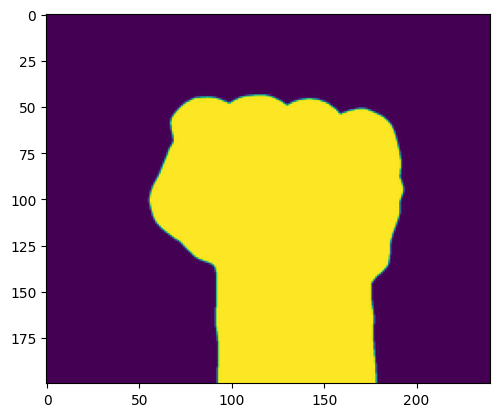

(1, 200, 240, 1)


In [41]:
img = Image.open("okay3.png")
for i in range(img.size[0]):
    for j in range(img.size[1]):
        if img.getpixel((i, j))[0] > 230 and img.getpixel((i, j))[1] > 230 and img.getpixel((i, j))[2] > 230:
            img.putpixel((i, j), (0,0,0))
        else:
            img.putpixel((i, j), (255, 255, 255))
img = img.convert('L')
img = img.resize((240, 200), Image.LANCZOS)
img = np.array(img)
plt.imshow(img)
plt.show()
img = img.reshape(1, 200, 240, 1)
print(img.shape)


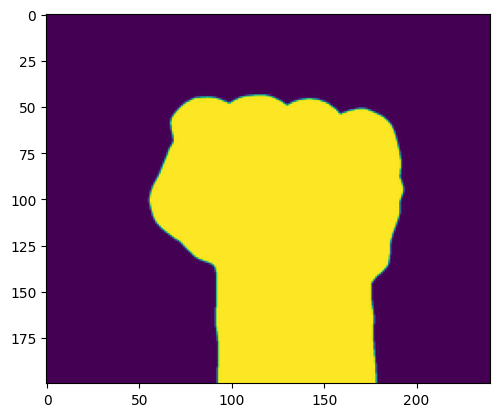

rock
[array([[3.1971749e-07, 1.3945986e-08, 9.9999964e-01]], dtype=float32)]


In [42]:
predictions = onnx_predicted_label = sess.run(output_names=[output_name], input_feed={intput_name: img.astype(np.float32)})
plt.imshow(img.reshape(200, 240))
plt.show()
print(labels[np.argmax(predictions)])
print(predictions)